## Management Zones Using Yield Monitor 

Get field boundary from https://geojason.io/

In [2]:
# Import modules 
import numpy as np
import geopandas as gpd
import matplotlib.pyplot as plt

from shapely.geometry import box

In [3]:
# Read the file 
gdf = gpd.read_file('Mortimer/Soybeans.shp')
gdf.head()

,GrowerName,FieldName,CrpZnName,Load,Variety,LoadVar,MachineID,TimeStamp,Date,Time,Yield,Flow,Moisture,Duration,Distance,Width,Area,geometry
0,Knopf Farms,Mortimer's,Soybeans,17/09/30-18:37:10,None,17/09/30-18:37:10,222486,2017-09-30 18:38:56,2017-09-30,18:38:56,61.45,2.7965,13.0,1.0,21.8504,480.0,0.001672,POINT (-97.43268 38.71256)
1,Knopf Farms,Mortimer's,Soybeans,17/09/30-18:37:10,None,17/09/30-18:37:10,222486,2017-09-30 18:38:57,2017-09-30,18:38:57,49.74,2.1531,13.0,1.0,20.7874,480.0,0.001591,POINT (-97.43269 38.71255)
2,Knopf Farms,Mortimer's,Soybeans,17/09/30-18:37:10,None,17/09/30-18:37:10,222486,2017-09-30 18:38:58,2017-09-30,18:38:58,42.12,1.8202,13.0,1.0,20.7480,480.0,0.001588,POINT (-97.43269 38.71255)
3,Knopf Farms,Mortimer's,Soybeans,17/09/30-18:37:10,None,17/09/30-18:37:10,222486,2017-09-30 18:38:59,2017-09-30,18:38:59,39.80,1.6544,13.0,1.0,19.9606,480.0,0.001527,POINT (-97.43269 38.71255)
4,Knopf Farms,Mortimer's,Soybeans,17/09/30-18:37:10,None,17/09/30-18:37:10,222486,2017-09-30 18:39:00,2017-09-30,18:39:00,59.34,2.3987,13.0,1.0,19.4094,480.0,0.001485,POINT (-97.43270 38.71254)


In [4]:
# Add speed column 

gdf['Speed'] = gdf['Distance']/gdf['Duration']/12*0.68 # Units --> Mph and inches 

In [5]:
# Inspect data in tabular format 
gdf[['Yield', 'Moisture', 'Speed']].describe()

,Yield,Moisture,Speed
count,36426.000000,36426.000000,36426.000000
mean,46.005093,10.472791,3.613725
std,38.166806,2.189875,0.785171
min,0.000000,4.700000,0.267716
25%,34.080000,9.600000,3.043045
50%,44.690000,9.900000,3.725720
75%,56.467500,10.100000,4.232150
max,4150.990000,18.100000,6.893698


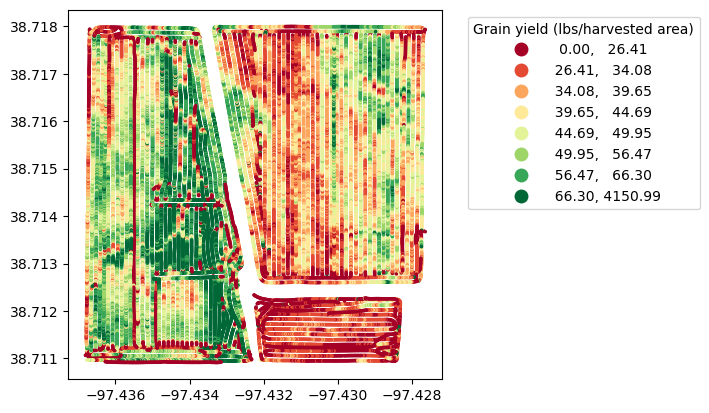

In [6]:
# Visualize data 
fig, ax = plt.subplots(nrows = 1, ncols = 1)
gdf.plot(ax = ax,
        column = 'Yield',
        k = 8,
        scheme = 'quantiles',
        cmap = 'RdYlGn',
        legend = True,
        marker = '.',
        markersize = 10,
        legend_kwds = {'loc':'upper left', 'bbox_to_anchor':(1.05, 1), 'title':'Grain yield (lbs/harvested area)'});

ax.ticklabel_format(useOffset = False)

,geometry
0,"POLYGON ((-97.43685 38.71813, -97.43693 38.710..."


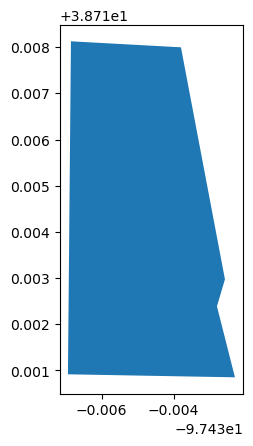

In [7]:
# Read the boundaries of the file  
bnd = gpd.read_file('Mortimer/mortimer_west.geojson')
bnd.plot()
bnd.head()

In [8]:
# Clip the yield monitor data to field boundaries 
gdf = gpd.clip(gdf, bnd['geometry'].iloc[0])
gdf.reset_index(drop = True, inplace = True)
gdf.head()

,GrowerName,FieldName,CrpZnName,Load,Variety,LoadVar,MachineID,TimeStamp,Date,Time,Yield,Flow,Moisture,Duration,Distance,Width,Area,geometry,Speed
0,Knopf Farms,Mortimer's,Soybeans,11,None,11,222486,2017-10-02 11:44:21,2017-10-02,11:44:21,5.21,0.7464,13.0,1.0,68.8189,480.0,0.005266,POINT (-97.43575 38.71092),3.899738
1,Knopf Farms,Mortimer's,Soybeans,11,None,11,222486,2017-10-02 11:44:20,2017-10-02,11:44:20,6.94,0.9996,13.0,1.0,69.1732,480.0,0.005293,POINT (-97.43573 38.71092),3.919815
2,Knopf Farms,Mortimer's,Soybeans,11,None,11,222486,2017-10-02 11:44:23,2017-10-02,11:44:23,6.07,0.8866,13.0,1.0,70.0787,480.0,0.005363,POINT (-97.43579 38.71092),3.971126
3,Knopf Farms,Mortimer's,Soybeans,11,None,11,222486,2017-10-02 11:44:22,2017-10-02,11:44:22,4.22,0.6124,13.0,1.0,69.7244,480.0,0.005336,POINT (-97.43577 38.71092),3.951049
4,Knopf Farms,Mortimer's,Soybeans,11,None,11,222486,2017-10-02 11:44:19,2017-10-02,11:44:19,7.09,1.0478,13.0,1.0,70.9449,480.0,0.005429,POINT (-97.43571 38.71092),4.020211


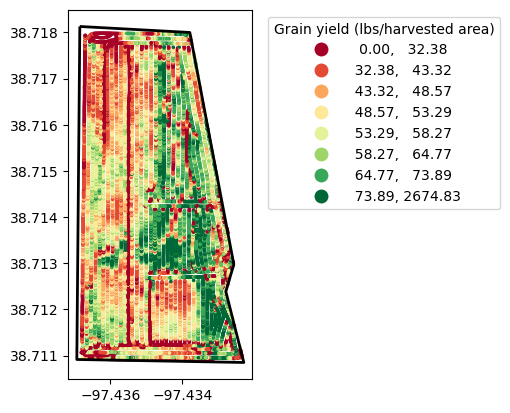

In [9]:
# Visualize data 
fig, ax = plt.subplots(nrows = 1, ncols = 1)
gdf.plot(ax = ax,
        column = 'Yield',
        k = 8,
        scheme = 'quantiles',
        cmap = 'RdYlGn',
        legend = True,
        marker = '.',
        markersize = 10,
        legend_kwds = {'loc':'upper left', 'bbox_to_anchor':(1.05, 1), 'title':'Grain yield (lbs/harvested area)'});

bnd.plot(ax = ax, linewidth = 2, facecolor = 'None', edgecolor = 'k')

ax.ticklabel_format(useOffset = False)

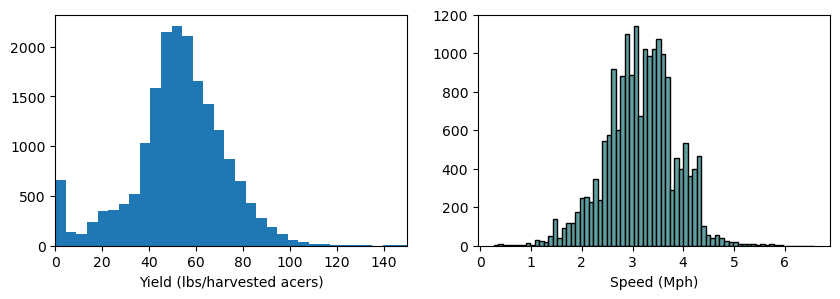

In [10]:
# Histograms of yield and speed 
plt.figure(figsize=(10, 3))

plt.subplot(1, 2, 1)
plt.hist(gdf['Yield'], bins = "scott");
plt.xlabel('Yield (lbs/harvested acers)')
plt.xlim(0, 150)


plt.subplot(1, 2, 2)
plt.hist(gdf['Speed'], bins = "scott", edgecolor = 'k', facecolor = 'cadetblue');
plt.xlabel('Speed (Mph)')


plt.show()

In [11]:
# Create a function to apply the Interquartile range method for detecting outliers 

def iqr_fn(y):
    ''' Function to compute the IQR'''
    quantiles = [0.25, 0.50, 0.75]
    Q1, Q2, Q3 = y.quantile(quantiles)
    IQR = Q3 - Q1
    idx_outliers = (y < Q2 - 1.5*IQR) | (y > Q2 + 1.5*IQR) 
    return(idx_outliers)

In [12]:
# Use our function to find outliers 
idx_yield = iqr_fn(gdf['Yield'])
idx_speed = iqr_fn(gdf['Speed'])

idx_all_outliers = idx_yield | idx_speed

gdf.loc[idx_all_outliers, 'Yield'] = np.nan

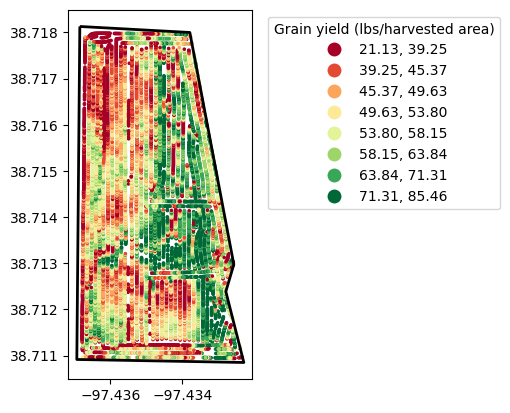

In [13]:
# Visualize data 
fig, ax = plt.subplots(nrows = 1, ncols = 1)
gdf.plot(ax = ax,
        column = 'Yield',
        k = 8,
        scheme = 'quantiles',
        cmap = 'RdYlGn',
        legend = True,
        marker = '.',
        markersize = 10,
        legend_kwds = {'loc':'upper left', 'bbox_to_anchor':(1.05, 1), 'title':'Grain yield (lbs/harvested area)'});

bnd.plot(ax = ax, linewidth = 2, facecolor = 'None', edgecolor = 'k')

ax.ticklabel_format(useOffset = False)

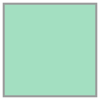

In [34]:
# Learn what the box function does 
box(0, 0, 20, 20)

In [35]:
# Specify coordinates reference systems 
epsg_utm = 32614 # UTM Zone 14
epsg_wgs = 4326 # WGS84

In [36]:
# Define box of the field 
xmin, ymin, xmax, ymax = bnd.to_crs(epsg = epsg_utm).total_bounds

# Define the boxsize 
xdelta = 10 # meters 
ydelta = 10 # meters 

# create an empty numpy array 
grid = np.array([])

# Iterate to create each box
for x in np.arange(xmin, xmax, xdelta): 
    for y in np.arange(ymin, ymax, ydelta): 
        cell = box(x, y, x+xdelta, y+ydelta)
        grid = np.append(grid, cell)

#convert the grid to a GeoDataframe 
gdf_grid = gpd.GeoDataFrame(grid, columns = ['geometry'], crs = epsg_utm)

# Get centroids of each cell 
gdf_grid['centroids'] = gdf_grid['geometry'].centroid

gdf_grid.head()

,geometry,centroids
0,"POLYGON ((635905.168 4285856.611, 635905.168 4...",POINT (635900.168 4285861.611)
1,"POLYGON ((635905.168 4285866.611, 635905.168 4...",POINT (635900.168 4285871.611)
2,"POLYGON ((635905.168 4285876.611, 635905.168 4...",POINT (635900.168 4285881.611)
3,"POLYGON ((635905.168 4285886.611, 635905.168 4...",POINT (635900.168 4285891.611)
4,"POLYGON ((635905.168 4285896.611, 635905.168 4...",POINT (635900.168 4285901.611)


In [37]:
# Change to coordinate reference system 
gdf_grid['geometry'] = gdf_grid['geometry'].to_crs(epsg = epsg_wgs)
gdf_grid['centroids'] = gdf_grid['centroids'].to_crs(epsg = epsg_wgs)

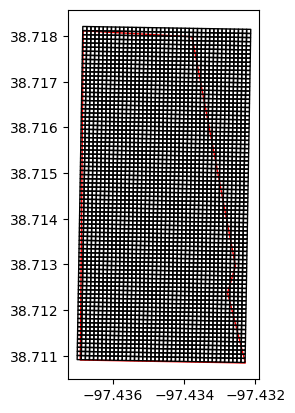

In [38]:
# Create plot a field and boundary 

fig, ax = plt.subplots(1, 1)
bnd.plot(ax = ax, facecolor = 'w', edgecolor = 'r')
gdf_grid.plot(ax = ax, facecolor = 'None', edgecolor = 'k')
ax.ticklabel_format(useOffset = False)
plt.show()

In [39]:
# Clip cells to field boundary 
gdf_grid = gpd.clip(gdf_grid, bnd['geometry'].iloc[0])
gdf_grid.reset_index(drop = True, inplace = True)

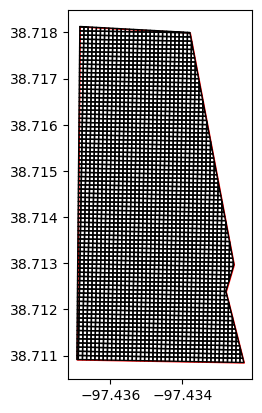

In [41]:
# Create plot a field and boundary 

fig, ax = plt.subplots(1, 1)
bnd.plot(ax = ax, facecolor = 'w', edgecolor = 'r')
gdf_grid.plot(ax = ax, facecolor = 'None', edgecolor = 'k')
ax.ticklabel_format(useOffset = False)
plt.show()

In [42]:
# Iterate over each cell to compute the median yield 
grid_yield = []
for k, row in gdf_grid.iterrows():
    idx_within_cell = gdf['geometry'].within(row['geometry'])
    yield_value = gdf.loc[idx_within_cell, 'Yield'].median()
    grid_yield.append(yield_value)
    
# Append new column to the gdf_grid
gdf_grid['Yield'] = grid_yield
gdf_grid.head()

,geometry,centroids,Yield
0,"POLYGON ((-97.43459 38.71097, -97.43447 38.710...",POINT (-97.43453 38.71093),46.800
1,"POLYGON ((-97.43470 38.71097, -97.43459 38.710...",POINT (-97.43465 38.71093),40.510
2,"POLYGON ((-97.43459 38.71097, -97.43459 38.711...",POINT (-97.43453 38.71102),49.325
3,"POLYGON ((-97.43470 38.71097, -97.43470 38.711...",POINT (-97.43465 38.71102),51.340
4,"POLYGON ((-97.43459 38.71106, -97.43458 38.711...",POINT (-97.43453 38.71111),NaN


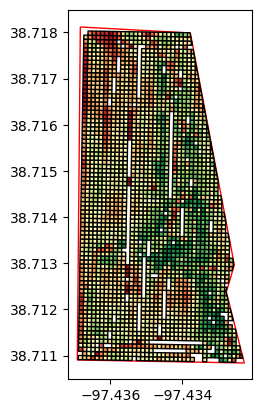

In [43]:
# Create plot a field and boundary 

fig, ax = plt.subplots(1, 1)
bnd.plot(ax = ax, facecolor = 'w', edgecolor = 'r')
gdf_grid.plot(ax = ax, column = 'Yield', edgecolor = 'k', cmap = 'RdYlGn')
ax.ticklabel_format(useOffset = False)
plt.show()

In [56]:
# Clustering using K-means 
from sklearn.cluster import KMeans
gdf_grid.dropna(inplace = True)
kmeans_info = KMeans(n_clusters=3).fit(gdf_grid['Yield'].values.reshape(-1, 1))

gdf_grid['zone'] = kmeans_info.labels_.flatten()
gdf_grid.head()

,geometry,centroids,Yield,zone
0,"POLYGON ((-97.43459 38.71097, -97.43447 38.710...",POINT (-97.43453 38.71093),46.800,0
1,"POLYGON ((-97.43470 38.71097, -97.43459 38.710...",POINT (-97.43465 38.71093),40.510,1
2,"POLYGON ((-97.43459 38.71097, -97.43459 38.711...",POINT (-97.43453 38.71102),49.325,0
3,"POLYGON ((-97.43470 38.71097, -97.43470 38.711...",POINT (-97.43465 38.71102),51.340,0
6,"POLYGON ((-97.43458 38.71115, -97.43458 38.711...",POINT (-97.43453 38.71120),41.620,1


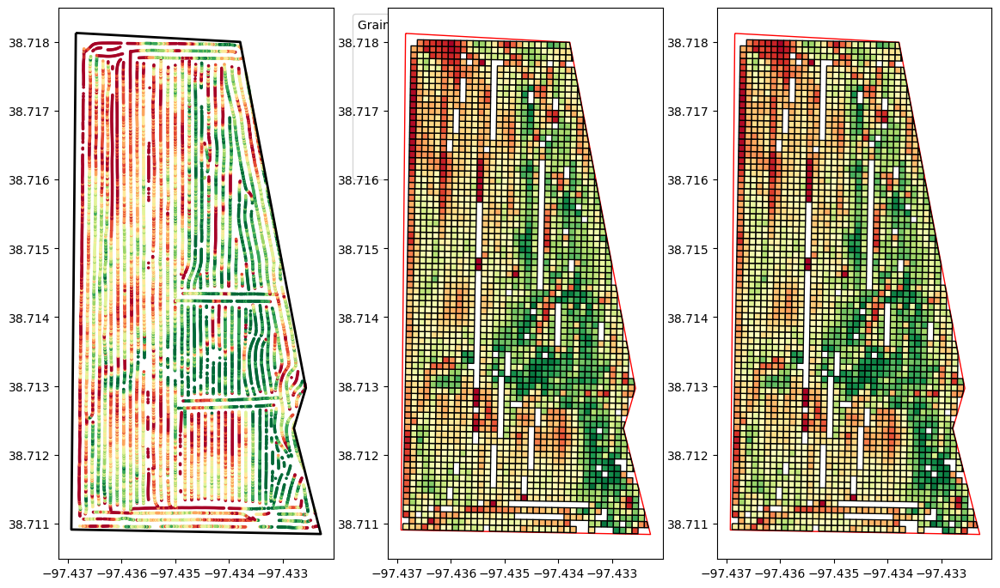

In [77]:
#Visualize the management zones 
# Create plot a field and boundary 

fig, ax = plt.subplots(1, 3, figsize = (14, 12))

gdf.plot(ax = ax[0],
        column = 'Yield',
        k = 8,
        scheme = 'quantiles',
        cmap = 'RdYlGn',
        legend = True,
        marker = '.',
        markersize = 10,
        legend_kwds = {'loc':'upper left', 'bbox_to_anchor':(1.05, 1), 'title':'Grain yield (lbs/harvested area)'});
bnd.plot(ax = ax[0], linewidth = 2, facecolor = 'None', edgecolor = 'k')

bnd.plot(ax = ax[1], facecolor = 'w', edgecolor = 'r')
gdf_grid.plot(ax = ax[1], column = 'Yield', edgecolor = 'k', cmap = 'RdYlGn')

bnd.plot(ax = ax[2], facecolor = 'w', edgecolor = 'r')
gdf_grid.plot(ax = ax[2], column = 'Yield', edgecolor = 'k', cmap = 'RdYlGn')

ax[0].ticklabel_format(useOffset = False)
ax[1].ticklabel_format(useOffset = False)
ax[2].ticklabel_format(useOffset = False)


plt.show()

In [76]:
gdf.explore(column = "Yield", cmap = "RdYlGn", tooltip = "Yield", popup = True,
           tiles = "CartoDB positron",
           style_kwds = dict(color = "None", fillOpacity = 1.0),
           tooltip_kwds=dict(aliases=['Yield (%)']))